# Image Captioning
<img src="static/sheep.png" align="center"/>

Image captioning is a process of **describing content in the image**. As we already know, neural networks can understand the content of the image and they also can generate text. MIX and we get NN for image captioning. As a reference paper we'll use [Show, Attend and Tell: Neural Image Caption Generation with Visual Attention](https://arxiv.org/abs/1502.03044). It's a really good idea to read the paper before doing this homework.

Here's a brief overview of the paper (reference to [this repository](https://github.com/sgrvinod/a-PyTorch-Tutorial-to-Image-Captioning#concepts)):

## Encoder

The encoder encodes the input image with 3 color channels into a feature map which is a summary representation of all that's useful in the image. We use fully-conv architecture for it. Don't train encoder from scratch, but use pretrained CNN. E.g. you can use ResNet-101 pretrained on ImageNet from [torchvision models](https://pytorch.org/docs/stable/torchvision/models.html).

To keep encoder's output feature maps of fixed size you can use [nn.AdaptiveAvgPool2d](https://pytorch.org/docs/stable/nn.html#torch.nn.AdaptiveAvgPool2d).


<img src="static/encoder.png" align="center"/>

## Decoder

The decoder's job is to look at the encoded image and generate caption **word-by-word** (note, at the `08 seminar` generated sequences token-by-token). Since we generate sequence, we'll Recurrent Neural Network (LSTM). To feed image information to RNN we 1) average `(h, w)` dimensions of image feature map to get 1D vector, then 2) transform this vector with linear layer to fit the size of the RNN's hidden state and 3) pass it as an initial hidden state $h_0$.

<img src="static/decoder_no_att.png" align="center"/>

## Attention

In a setting with attention, we want the decoder to be able to look at different parts of the image at different timestamps in the sequence. For example, while generating the word `football` it's a good idea to look at image area, where football is located!

Instead of the simple averaging (like before), we use the **weighted averaging** across all pixels. This weighted representation of the image can be concatenated with the previously generated word at each timestamp to generate the next word.

<img src="static/decoder_att.png" align="center"/>


The attention network **computes these weights**. How would you estimate the importance of a certain part of an image? You would need to be aware of the sequence you have generated so far, so you can look at the image and decide what needs describing next. For example, after you mention a man, it is logical to declare that he is holding a football.

This is exactly what the attention mechanism does – it considers the sequence generated thus far, and attends to the part of the image that needs describing next.


<img src="static/att.png" align="center"/>

We'll use **soft** attention, where the weights of the pixels add up to 1. If there are $P$ pixels in our encoded image, then at each timestep $t$:



<img src="static/weights.png" align="center"/>

## Beam search

We use a linear layer to transform the decoder's output into a score for each word in the vocabulary.

The straightforward and greedy (just like we did at the `08 seminar`) option would be to choose the word with the highest score and use it to predict the next word. But this is not optimal because the rest of the sequence hinges on that first word you choose. If that choice isn't the best, everything that follows is sub-optimal. And it's not just the first word – each word in the sequence has consequences for the ones that succeed it.

It might happen that if you'd chosen the third best word at that first step, and the second best word at the second step, and so on... that would be the best sequence you could generate.

It would be best if we could somehow not decide until we've finished decoding completely, and choose the sequence that has the highest overall score from a basket of candidate sequences.

Beam Search does exactly this.

1. At the first decode step, consider the top k candidates.
2. Generate k second words for each of these k first words.
3. Choose the top k [first word, second word] combinations considering additive scores.
4. For each of these k second words, choose k third words, choose the top k [first word, second word, third word] combinations.
5. Repeat at each decode step.

After k sequences terminate, choose the sequence with the best overall score.


<img src="static/beam_search.png" align="center"/>

## Data
We'll use [Flickr8K dataset](http://nlp.cs.illinois.edu/HockenmaierGroup/8k-pictures.html). The Flickr 8K dataset includes images obtained from the Flickr website. Each image has several captions annotated by humans. To download the dataset follow [this link](http://nlp.cs.illinois.edu/HockenmaierGroup/8k-pictures.html) (use your academic e-mail for faster approvement).

## Game rules:
Maximum score you can get for this task is **10.0**.

1. **Baseline (5 points):** implement Encoder-Decoder network which generates worthy captions (without attention and beam search).
2. **+ attention (3 points):** add attention mechanism to the implemented baseline (+ visualize attention masks).
3. **+ beam search (2 points):** implement beam search generation algorithm.

We won't use any quantitative metric to measure quality. We'll just look at your generated captions for **20 images** from Flickr8K not used during training and **5 random images** from the Internet (you can choose any). 

So the result of your homework should be:
1. Code
2. 20 + 5 images with generated captions (+ attention masks if you implemented attention mechanism)
3. Short report about things you tried and what parts you managed to implement

In [0]:
## A LOT OF YOUR CODE HERE

In [0]:
from google.colab import drive
drive.mount('/content/drive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive/
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [0]:
import pandas as pd
import numpy as np
import os
import h5py
import json

import torch
from torch.utils.data import Dataset
import torch.utils.data
import torchvision.transforms as transforms
import torch.nn.functional as F
from torch.nn.utils.rnn import pack_padded_sequence

from tqdm import tqdm_notebook as tqdm
from collections import Counter

from scipy.misc import imread, imresize
from random import seed, choice, sample

from PIL import Image
from matplotlib import pyplot as plt
import skimage.transform
import matplotlib.cm as cm

# IMAGE_FOLDER = '/content/drive/My Drive/hw2/flickr30k_images/flickr30k_images/'
# CAPTIONS_FOLDER = '/content/drive/My Drive/hw2/flickr30k_images/results.csv'
# DATA_FOLDER = '/content/drive/My Drive/hw2/preprocessed_data/'
EMBEDDINGS_PATH = '/content/drive/My Drive/journal_club/randsent/glove.840B.300d.txt'

IMAGE_FOLDER = '/content/drive/My Drive/hw2/flickr8k_images/flickr8k_images/'
CAPTIONS_FOLDER = '/content/drive/My Drive/hw2/flickr8k_images/results.csv'
DATA_FOLDER = '/content/drive/My Drive/hw2/preprocessed_data/'
#EMBEDDINGS_PATH = '/content/drive/My Drive/journal_club/randsent/glove.6B.300d.txt'

MAX_CAPTION_LEN = 12
MIN_FREQUENCY = 5
CAPTION_PER_IMAGE = 5


# DATA PREPARE

In [0]:
captions = pd.read_csv(CAPTIONS_FOLDER, sep='|')
captions.fillna('', inplace=True)

In [0]:
captions.head()

,image_name,comment_number,comment
0,1305564994_00513f9a5b.jpg,0,A man in street racer armor be examine the tir...
1,1305564994_00513f9a5b.jpg,1,Two racer drive a white bike down a road .
2,1305564994_00513f9a5b.jpg,2,Two motorist be ride along on their vehicle th...
3,1305564994_00513f9a5b.jpg,3,Two person be in a small race car drive by a g...
4,1305564994_00513f9a5b.jpg,4,Two person in race uniform in a street car .


In [0]:
print(np.mean(list(map(lambda s: len(s.split()), captions['comment']))))

11.75850222441918


In [0]:
grouped_comments = captions.groupby(by='image_name').apply(lambda s: s['comment'].values.tolist())
grouped_comments = grouped_comments.sample(frac=1.)

In [0]:
grouped_comments.head()

image_name
1295669416_21cabf594d.jpg    [A girl dress in a red and black top with blac...
3288173388_03bc2a844d.jpg    [A girl in a Burka be learn vocabulary in a cl...
782401952_5bc5d3413a.jpg     [A group of teenager near Simpson character .,...
2072574835_febf0c5fb9.jpg    [Dog in a race ., Greyhound dog wear race stri...
3197482764_2f289cb726.jpg    [Two girl be dress up and sit on a bed laugh ....
dtype: object

In [0]:
train_image_paths = []
train_image_captions = []
val_image_paths = []
val_image_captions = []

In [0]:
length = len(grouped_comments)
train_len = int(length * 0.85)
val_len = int(length * 0.15)

In [0]:
grouped_comments.iloc[1]

['A girl in a Burka be learn vocabulary in a classroom .',
 'A man point to a blackboard to show a child something .',
 'A man teach English to a young girl in a rural African village .',
 'one person point at a chalkboard with a student look on',
 'A man write something on a chalkboard to teach a girl who be stand next to him .']

In [0]:
word_counter = Counter()

for i, image_path in tqdm(enumerate(grouped_comments.index)):
    captions = []
    for j, caption in enumerate(grouped_comments.iloc[i]): 
        splitted = caption.split()
        word_counter.update(splitted)
        if len(splitted) < MAX_CAPTION_LEN and len(splitted) > 0:
            captions.append(splitted)
    
    if not captions:
        continue
    
    if i < train_len:
        train_image_paths.append(image_path)
        train_image_captions.append(captions)
    else:
        val_image_paths.append(image_path)
        val_image_captions.append(captions)

In [0]:
# !ls '/content/drive/My Drive/hw2/'
# !mkdir '/content/drive/My Drive/hw2/test20'

# n_test = 20
# for i in range(n_test):
#   im_p = '/content/drive/My\ Drive/hw2/flickr8k_images/flickr8k_images/' + np.random.choice(val_image_paths, 1, False)[0]
#   # print(im_p)
#   !cp {im_p} '/content/drive/My Drive/hw2/test20/'

In [0]:
words = [w for w in word_counter.keys() if word_counter[w] > MIN_FREQUENCY]
word_map = {k: v + 1 for v, k in enumerate(words)}
word_map['<unk>'] = len(word_map) + 1
word_map['<start>'] = len(word_map) + 1
word_map['<end>'] = len(word_map) + 1
word_map['<pad>'] = 0


with open(os.path.join(DATA_FOLDER, 'WORD_MAP2.json'), 'w') as j:
    json.dump(word_map, j)

In [0]:
def process_image(image_path):
    img = imread(image_path)
    if len(img.shape) == 2:
        img = img[:, :, np.newaxis]
        img = np.concatenate([img, img, img], axis=2)
    img = imresize(img, (256, 256))
    img = img.transpose(2, 0, 1)
    assert img.shape == (3, 256, 256)
    assert np.max(img) <= 255
    return img

In [0]:
train_image_paths_correct = []
val_image_paths_correct = []

for f in train_image_paths:
  if f.endswith('.jpg'):
    train_image_paths_correct.append(f)
    
for f in val_image_paths:
  if f.endswith('.jpg'):
    val_image_paths_correct.append(f)
    
print(len(train_image_paths), len(train_image_paths_correct))
print(len(val_image_paths), len(val_image_paths_correct))

train_image_paths = train_image_paths_correct
val_image_paths = val_image_paths_correct

6477 6477
1141 1140


In [0]:
for impaths, imcaps, split in [(train_image_paths, train_image_captions, 'TRAIN'),
                                (val_image_paths, val_image_captions, 'VAL')]:
    
    with h5py.File(os.path.join(DATA_FOLDER, split + '_IMAGES2.hdf5'), 'a') as h:
        images = h.create_dataset('images', (len(impaths), 3, 256, 256), dtype='uint8')
        
        encoded_captions = []
        caption_lengths = []
        
        for i, path in enumerate(tqdm(impaths)):
                if len(imcaps[i]) < CAPTION_PER_IMAGE:
                    captions = imcaps[i] + [choice(imcaps[i]) for _ in range(CAPTION_PER_IMAGE - len(imcaps[i]))]
                else:
                    captions = sample(imcaps[i], k=CAPTION_PER_IMAGE)

                assert len(captions) == CAPTION_PER_IMAGE
                
                images[i] = process_image(IMAGE_FOLDER + path)


                for j, c in enumerate(captions):
                    encoded_caption = [word_map['<start>']] + [word_map.get(word, word_map['<unk>']) for word in c] + [
                        word_map['<end>']] + [word_map['<pad>']] * (MAX_CAPTION_LEN - len(c))

                    encoded_captions.append(encoded_caption)
                    caption_lengths.append(len(c) + 2)
                    
        assert images.shape[0] * CAPTION_PER_IMAGE == len(encoded_captions) == len(caption_lengths)
        
        with open(os.path.join(DATA_FOLDER, split + '_CAPTIONS2.json'), 'w') as j:
            json.dump(encoded_captions, j)

        with open(os.path.join(DATA_FOLDER, split + '_CAPLENS2.json'), 'w') as j:
            json.dump(caption_lengths, j)

# LOAD DATASET

In [0]:
class CaptionDataset(Dataset):
    def __init__(self, split, transform=None):
        self.split = split
        self.cpi = CAPTION_PER_IMAGE

        self.h = h5py.File(os.path.join(DATA_FOLDER, self.split + '_IMAGES2.hdf5'), 'r')
        self.imgs = self.h['images']

        with open(os.path.join(DATA_FOLDER, self.split + '_CAPTIONS2.json'), 'r') as j:
            self.captions = json.load(j)

        with open(os.path.join(DATA_FOLDER, self.split + '_CAPLENS2.json'), 'r') as j:
            self.caplens = json.load(j)

        self.transform = transform
        self.dataset_size = len(self.captions)

    def __getitem__(self, i):
        img = torch.FloatTensor(self.imgs[i // self.cpi] / 255.)
        if self.transform is not None:
            img = self.transform(img)

        caption = torch.LongTensor(self.captions[i])
        caplen = torch.LongTensor([self.caplens[i]])

        if self.split == 'TRAIN':
            return img, caption, caplen
        else:
            all_captions = torch.LongTensor(
                self.captions[((i // self.cpi) * self.cpi):(((i // self.cpi) * self.cpi) + self.cpi)])
            return img, caption, caplen, all_captions

    def __len__(self):
        return self.dataset_size

# MODEL

In [0]:
from torch import nn
import torchvision

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [0]:
class Encoder(nn.Module):
  def __init__(self):
    super(Encoder, self).__init__()
    ENCODED_IMAGE_SIZE = 14
    pretrained_resnet = torchvision.models.resnet101(pretrained=True)
    self.features = nn.Sequential(*list(pretrained_resnet.children())[:-2])
    self.pool = nn.AdaptiveAvgPool2d((ENCODED_IMAGE_SIZE, ENCODED_IMAGE_SIZE))
    
    
    for p in self.features.parameters():
      p.requires_grad = False
      
  def forward(self, x):
    out = self.features(x)  
    out = self.pool(out)
    out = out.permute(0, 2, 3, 1)
    return out

In [0]:
class Attention(nn.Module):

    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        ENCODED_IMAGE_SIZE = 14
        super(Attention, self).__init__()
        self.linear1 = nn.Linear(encoder_dim, attention_dim)
        self.linear2 = nn.Linear(decoder_dim, attention_dim)
        self.linear3 = nn.Linear(attention_dim, 1)
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1) 

    def forward(self, encoder_out, decoder_hidden):
        all_image = self.linear1(encoder_out)
        last_glimpse = self.linear2(decoder_hidden)
        attention_logits = self.linear3(self.relu(all_image + last_glimpse.unsqueeze(1))).squeeze(2)
        attention_weights = self.softmax(attention_logits)
        new_glimpse = (encoder_out * attention_weights.unsqueeze(2)).sum(dim=1)

        return new_glimpse, attention_weights

In [0]:
class Decoder(nn.Module):
  def __init__(self, attention_dim, embed_dim, decoder_dim, vocab_size, encoder_dim=2048, dropout=0.5, embeddings=None):      
    super(Decoder, self).__init__()
    
    self.encoder_dim = encoder_dim
    self.attention_dim = attention_dim
    self.embed_dim = embed_dim
    self.decoder_dim = decoder_dim
    self.vocab_size = vocab_size
    self.dropout = dropout
     
    self.attention = Attention(encoder_dim, decoder_dim, attention_dim) 
    
    self.embedding = nn.Embedding(num_embeddings=vocab_size, embedding_dim=embed_dim)
    if embeddings is None:
      self.embedding.weight.data.uniform_(-0.1, 0.1)
    else:
      self.embedding.weight = nn.Parameter(embeddings)
      for p in self.embedding.parameters():
        p.requires_grad = False
    
    
    self.lstm = nn.LSTMCell(embed_dim + encoder_dim, decoder_dim, bias=True)
    self.init_h = nn.Linear(encoder_dim, decoder_dim)
    self.init_c = nn.Linear(encoder_dim, decoder_dim)
    
    self.gate = nn.Linear(decoder_dim, encoder_dim)
    self.sigmoid = nn.Sigmoid()
    
    self.dropout = nn.Dropout(p=self.dropout)
    self.fc = nn.Linear(decoder_dim, vocab_size)
    self.fc.bias.data.fill_(0)
    self.fc.weight.data.uniform_(-0.1, 0.1)
    
    
  def init_hidden_state(self, encoded_image):
      mean_encoded = encoded_image.mean(dim=1)
      init_hidden = self.init_h(mean_encoded)  
      init_cell = self.init_c(mean_encoded)
      return init_hidden, init_cell
    
    
  def forward(self, encoder_out, encoded_captions, caption_lengths):
      batch_size = encoder_out.size(0)
      encoder_dim = encoder_out.size(-1)
      vocab_size = self.vocab_size
      
      encoder_out = encoder_out.view(batch_size, -1, encoder_dim) 
      num_pixels = encoder_out.size(1)
      caption_lengths, sort_ind = caption_lengths.squeeze(1).sort(dim=0, descending=True)
      encoder_out = encoder_out[sort_ind]
      encoded_captions = encoded_captions[sort_ind]

      embeddings = self.embedding(encoded_captions)

      h_prev, c_prev = self.init_hidden_state(encoder_out)

      decode_lengths = (caption_lengths - 1).tolist()

      predictions = torch.zeros(batch_size, max(decode_lengths), vocab_size).to(device)
      weights = torch.zeros(batch_size, max(decode_lengths), num_pixels).to(device)

      for t in range(max(decode_lengths)):
        N_t = sum([l > t for l in decode_lengths])
        new_glimpse, weight = self.attention(encoder_out[:N_t],h_prev[:N_t])
        gate = self.sigmoid(self.gate(h_prev[:N_t]))
        new_glimpse = gate * new_glimpse
        h_prev, c_prev = self.lstm(torch.cat([embeddings[:N_t, t, :], new_glimpse], dim=1), (h_prev[:N_t], c_prev[:N_t]))  
        word_probas = self.fc(self.dropout(h_prev))
        predictions[:N_t, t, :] = word_probas
        weights[:N_t, t, :] = weight
          
      return predictions, encoded_captions, decode_lengths, weights, sort_ind
    


In [0]:
def load_vecs(word_emb_file, word2id, word_emb_dim=300): 
  embs = torch.FloatTensor(len(word2id), word_emb_dim)

  matches = 0
  n_words = len(word2id)
  embedding_vocab = []
  with open(word_emb_file) as f:
      for line in f:
          word = line.split(' ', 1)[0]
          embedding_vocab.append(word)
  embedding_vocab = set(embedding_vocab)

  word_map = {}
  cnt = len(word2id)
  for word in word2id:
      if word in embedding_vocab:
          word_map[word] = word2id[word]
      else:
          new_word = word.lower().capitalize()
          if new_word in embedding_vocab:
              word_map[new_word] = word2id[word]
          else:
              new_word = word.lower()
              if new_word in embedding_vocab:
                  word_map[new_word] = word2id[word]
              else:
                  cnt -= 1
  print('{} from {} found'.format(cnt, len(word2id)))

  with open(word_emb_file) as f:
      for line in f:
          word = line.split(' ', 1)[0]
          if word != '<pad>':
              if word in word_map:
                  glove_vect = torch.FloatTensor(list(map(float, line.split(' ', 1)[1].split(' '))))
                  embs[word_map[word]][:word_emb_dim] = torch.FloatTensor(glove_vect)

                  matches += 1
                  if matches == n_words: break
  return embs


In [0]:
def save_checkpoint(epoch, encoder, decoder, optimizer, top5, is_best):
    data = {'epoch': epoch, 'top5': top5, 'encoder': encoder, 
            'decoder': decoder, 'optimizer': optimizer}
    filename = f'/content/drive/My Drive/hw2/best_checkpoint3_{top5}.pth.tar'
    torch.save(data, filename)
    if is_best:
      torch.save(data, filename)

# TRAIN

In [0]:
word_emb_dim = 300
attention_dim = 200
decoder_dim = 200
dropout = 0.5

batch_size = 64
best_score = 61.15
checkpoint = '/content/drive/My Drive/hw2/best_checkpoint3_61.160417193999315.pth.tar'
epoch_counter = 0
max_epochs = 25

In [0]:
word_map_file = os.path.join(DATA_FOLDER, 'WORD_MAP2.json')
with open(word_map_file, 'r') as j:
  word_map = json.load(j)

In [0]:
if checkpoint is not None:
  pretrained = torch.load(checkpoint)
  epoch_counter = pretrained['epoch'] + 1
  encoder = pretrained['encoder']
  decoder = pretrained['decoder']
  optimizer = pretrained['optimizer']
  best_score = pretrained['top5']
else:
  encoder = Encoder()
  embs = load_vecs(EMBEDDINGS_PATH, word_map)
  decoder = Decoder(attention_dim=attention_dim, embed_dim=word_emb_dim, 
                               decoder_dim=decoder_dim, vocab_size=len(word_map), 
                               dropout=dropout, embeddings=embs)
  optimizer = torch.optim.Adam(params=filter(lambda p: p.requires_grad, decoder.parameters()), lr=0.001)

In [0]:
encoder = encoder.to(device)
decoder = decoder.to(device)
criterion = nn.CrossEntropyLoss().to(device)

In [0]:
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

train_loader = torch.utils.data.DataLoader(
    CaptionDataset('TRAIN', transform=transforms.Compose([normalize])),batch_size=batch_size, shuffle=True)
val_loader = torch.utils.data.DataLoader(
    CaptionDataset('VAL', transform=transforms.Compose([normalize])), batch_size=batch_size, shuffle=True)

print(len(train_loader), len(val_loader))

507 90


In [0]:
def accuracy(scores, targets, k):
  N_t = targets.size(0)
  top_scores, indices = scores.topk(k, 1, True, True)
  correct = indices.eq(targets.view(-1, 1).expand_as(indices))
  accuracy = correct.view(-1).float().sum()  
  return accuracy.item() * (100.0 / N_t)

In [0]:
for epoch in tqdm(range(epoch_counter, max_epochs)):
  #TRAIN
  encoder.train()
  decoder.train()
  
  running_loss = 0.
  mean_top5 = 0.
  for i, (images, captions, caption_lengths) in tqdm(enumerate(train_loader)):
    images = images.to(device)
    captions = captions.to(device)
    caption_lengths = caption_lengths.to(device)
    
    encoded_imgs = encoder(images)
    scores, caps_sorted, lengths, weights, sort_ind = decoder(encoded_imgs, captions, caption_lengths)
    targets = caps_sorted[:, 1:]
    
    scores, _ = pack_padded_sequence(scores, lengths, batch_first=True)
    targets, _ = pack_padded_sequence(targets, lengths, batch_first=True)
    
    loss = criterion(scores, targets)
    loss += ((1. - weights.sum(dim=1)) ** 2).mean()
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    
    
    running_loss += loss.item()
    mean_top5 += accuracy(scores, targets, 5)
    
  print("[epoch {}] train loss: {:.3}".format(epoch, running_loss / len(train_loader)))
  print("Train top5 accuracy on train images: {:.4}%".format(mean_top5 / len(train_loader)))

  
  #VALIDATE
  encoder.eval()
  decoder.eval()  

  val_running_loss = 0.
  val_mean_top5 = 0.
  with torch.no_grad():
    for i, (images, captions, caption_lengths, _) in tqdm(enumerate(val_loader)):

      images = images.to(device)
      captions = captions.to(device)
      caption_lengths = caption_lengths.to(device)

      encoded_imgs = encoder(images)
      scores, caps_sorted, lengths, weights, sort_ind = decoder(encoded_imgs, captions, caption_lengths)
      targets = caps_sorted[:, 1:]
      
      scores, _ = pack_padded_sequence(scores, lengths, batch_first=True)
      targets, _ = pack_padded_sequence(targets, lengths, batch_first=True)

      loss = criterion(scores, targets)
      loss += ((1. - weights.sum(dim=1)) ** 2).mean()
      
      val_running_loss += loss.item()
      val_mean_top5 += accuracy(scores, targets, 5)

  
  print("[epoch {}] val loss: {:.3}".format(epoch, val_running_loss / len(val_loader)))
  print("Val top5 accuracy on val images: {:.4}%".format(val_mean_top5 / len(val_loader)))

  recent_score = val_mean_top5 / len(val_loader)
  best_score = max(recent_score, best_score)
  is_best = best_score == recent_score

  save_checkpoint(epoch, encoder, decoder, optimizer, recent_score, is_best)

[epoch 0] train loss: 4.5
Train top5 accuracy on train images: 56.26%


[epoch 0] val loss: 4.25
Val top5 accuracy on val images: 57.77%


[epoch 1] train loss: 3.83
Train top5 accuracy on train images: 65.01%


[epoch 1] val loss: 4.15
Val top5 accuracy on val images: 59.36%


[epoch 2] train loss: 3.59
Train top5 accuracy on train images: 68.13%


[epoch 2] val loss: 4.11
Val top5 accuracy on val images: 60.03%


[epoch 3] train loss: 3.43
Train top5 accuracy on train images: 70.35%


[epoch 3] val loss: 4.08
Val top5 accuracy on val images: 60.93%


[epoch 4] train loss: 3.3
Train top5 accuracy on train images: 72.24%


[epoch 4] val loss: 4.08
Val top5 accuracy on val images: 61.14%


[epoch 5] train loss: 3.18
Train top5 accuracy on train images: 74.15%


[epoch 5] val loss: 4.11
Val top5 accuracy on val images: 61.09%


[epoch 6] train loss: 3.08
Train top5 accuracy on train images: 75.9%


[epoch 6] val loss: 4.15
Val top5 accuracy on val images: 60.91%


[epoch 7] train loss: 2.99
Train top5 accuracy on train images: 77.32%


[epoch 7] val loss: 4.18
Val top5 accuracy on val images: 61.16%


[epoch 8] train loss: 2.9
Train top5 accuracy on train images: 78.83%


[epoch 8] val loss: 4.2
Val top5 accuracy on val images: 61.04%


# TEST

In [0]:
ix2word = {v: k for k, v in word_map.items()}
# https://github.com/kelvinxu/arctic-captions/blob/master/alpha_visualization.ipynb

def visualize_att(image_path, encoded_caption, weights, ix2word):
  image = Image.open(image_path)
  image = image.resize([14 * 24, 14 * 24], Image.LANCZOS)

  words = [ix2word[i] for i in encoded_caption]

  fig = plt.figure(figsize=(16, 24))
  for i in range(len(words)):
    if i > MAX_CAPTION_LEN:
      break

    fig.add_subplot(np.ceil(len(words) / 4.), 4, i + 1)
    plt.text(0, 1, '%s' % (words[i]), color='black', backgroundcolor='white', fontsize=12)
    plt.imshow(image)
    current_step_weight = weights[i,:]
    weight = skimage.transform.resize(current_step_weight.numpy(), [14 * 24, 14 * 24])
    
    if i == 0:
        plt.imshow(weight, alpha=0)
    else:
        plt.imshow(weight, alpha=0.8)
        
    plt.set_cmap(cm.Greys_r)
    plt.axis('off')
  plt.show()

In [0]:
def caption_image_beam_search(encoder, decoder, image_path, word_map, k=3):
  final_sequences = list()
  final_sequences_weights = list()
  final_sequences_scores = list()
  vocab_size = len(word_map)

  image = process_image(image_path) / 255
  image = torch.FloatTensor(image)
  normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
  transform = transforms.Compose([normalize])
  image = transform(image) 

  image = image.unsqueeze(0)
  image = image.to(device)
  encoded_image = encoder(image) 
  enc_image_size = encoded_image.size(1)
  encoder_dim = encoded_image.size(3)
  encoder_out = encoded_image.view(1, -1, encoder_dim)
  num_pixels = encoder_out.size(1)
  encoder_out = encoder_out.expand(k, num_pixels, encoder_dim)

  top_k_previous_words = torch.LongTensor([[word_map['<start>']]] * k).to(device)  
  top_k_previous_sequences = top_k_previous_words
  top_k_sequences_scores = torch.zeros(k, 1).to(device)
  top_k_sequences_weights = torch.ones(k, 1, enc_image_size, enc_image_size).to(device)

  step = 1
  h_prev, c_prev = decoder.init_hidden_state(encoder_out)

  while True:
    embs = decoder.embedding(top_k_previous_words).squeeze(1)

    new_glimpse, weight = decoder.attention(encoder_out, h_prev)
    weight = weight.view(-1, enc_image_size, enc_image_size)
    new_glimpse = decoder.sigmoid(decoder.gate(h_prev)) * new_glimpse
    h_prev, c_prev = decoder.lstm(torch.cat([embs, new_glimpse], dim=1), (h_prev, c_prev))
    scores = F.log_softmax(decoder.fc(h_prev), dim=1)

    scores = top_k_sequences_scores.expand_as(scores) + scores

    if step == 1:
        top_k_scores, top_k_words = scores[0].topk(k, 0, True, True)
    else:
        top_k_scores, top_k_words = scores.view(-1).topk(k, 0, True, True)

    prev_word_inds = top_k_words / vocab_size
    next_word_inds = top_k_words % vocab_size

    top_k_previous_sequences = torch.cat([top_k_previous_sequences[prev_word_inds], next_word_inds.unsqueeze(1)], dim=1)
    top_k_sequences_weights = torch.cat([top_k_sequences_weights[prev_word_inds], weight[prev_word_inds].unsqueeze(1)], dim=1)

    
    incomplete_inds = [i for i, word in enumerate(next_word_inds) if word != word_map['<end>']]
    complete_inds = list(set(range(len(next_word_inds))) - set(incomplete_inds))


    if len(complete_inds) > 0:
        final_sequences.extend(top_k_previous_sequences[complete_inds].tolist())
        final_sequences_weights.extend(top_k_sequences_weights[complete_inds].tolist())
        final_sequences_scores.extend(top_k_scores[complete_inds])
    k -= len(complete_inds)  

    if k == 0:
        break
    top_k_previous_sequences = top_k_previous_sequences[incomplete_inds]
    top_k_sequences_weights = top_k_sequences_weights[incomplete_inds]
    top_k_sequences_scores =  top_k_sequences_scores[incomplete_inds]

    h_prev = h_prev[prev_word_inds[incomplete_inds]]
    c_prev = c_prev[prev_word_inds[incomplete_inds]]
    encoder_out = encoder_out[prev_word_inds[incomplete_inds]]
    top_k_scores = top_k_scores[incomplete_inds].unsqueeze(1)
    top_k_previous_words = next_word_inds[incomplete_inds].unsqueeze(1)

    if step > MAX_CAPTION_LEN:
        if len(final_sequences) == 0:
          final_sequences = top_k_previous_sequences.tolist()
          final_sequences_scores = top_k_sequences_scores.tolist()
          final_sequences_weights = top_k_sequences_weights.tolist()
        break
    step += 1


  i = final_sequences_scores.index(max(final_sequences_scores))
  final_caption = final_sequences[i]
  final_weight = final_sequences_weights[i]

  return final_caption, final_weight

In [0]:
def process_image(image_path):
    img = imread(image_path)
    if len(img.shape) == 2:
        img = img[:, :, np.newaxis]
        img = np.concatenate([img, img, img], axis=2)
    img = imresize(img, (256, 256))
    img = img.transpose(2, 0, 1)
    assert img.shape == (3, 256, 256)
    assert np.max(img) <= 255
    return img

# Visualize

In [0]:
print(os.listdir('/content/drive/My Drive/hw2/test20'))
print(os.listdir('/content/drive/My Drive/hw2/test5'))

['746787916_ceb103069f.jpg', '1269470943_ba7fc49b4d.jpg', '3609999845_faf5d2fe74.jpg', '1547883892_e29b3db42e.jpg', '1138784872_69ade3f2ab.jpg', '3394654132_9a8659605c.jpg', '2169951750_495820a215.jpg', '3109704348_c6416244ce.jpg', '2572101672_4d699c8713.jpg', '3702038926_966fdaa311.jpg', '3514019869_7de4ece2a5.jpg', '3225226381_9fe306fb9e.jpg', '2381583688_a6dd0a7279.jpg', '3183060123_ea3af6278b.jpg', '1311132744_5ffd03f831.jpg', '575636303_b0b8fd4eee.jpg', '2066271441_1f1f056c01.jpg', '2298283771_fb21a4217e.jpg', '1489286545_8df476fa26.jpg', '2695085862_2ed62df354.jpg']
['6.jpg', '2.jpg', '1.jpg', '3.jpg', '4.jpg', '5.jpg']


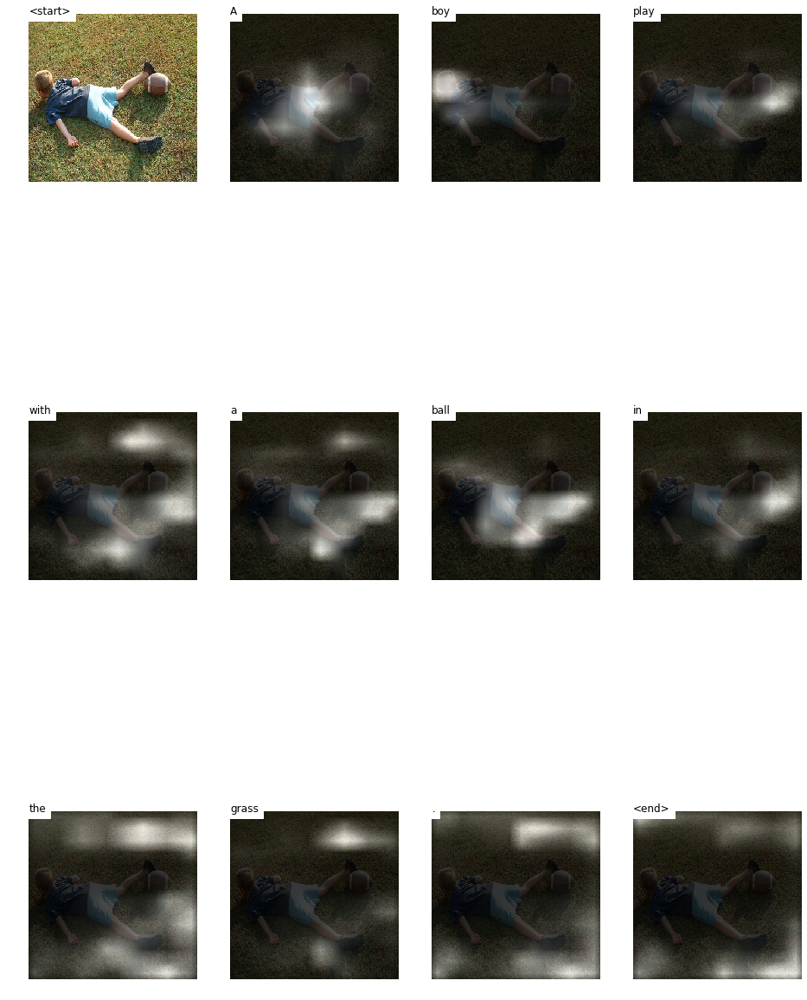

In [0]:
import warnings
warnings.filterwarnings('ignore')

encoder.eval()
decoder.eval()
image_path = '/content/drive/My Drive/hw2/test20/' + '1269470943_ba7fc49b4d.jpg'
final_caption, final_weight = caption_image_beam_search(encoder, decoder, image_path, word_map, k=3)
final_weight = torch.FloatTensor(final_weight)
visualize_att(image_path, final_caption, final_weight, ix2word)

### 20 test images

IMAGE PATH: /content/drive/My Drive/hw2/test20/746787916_ceb103069f.jpg 




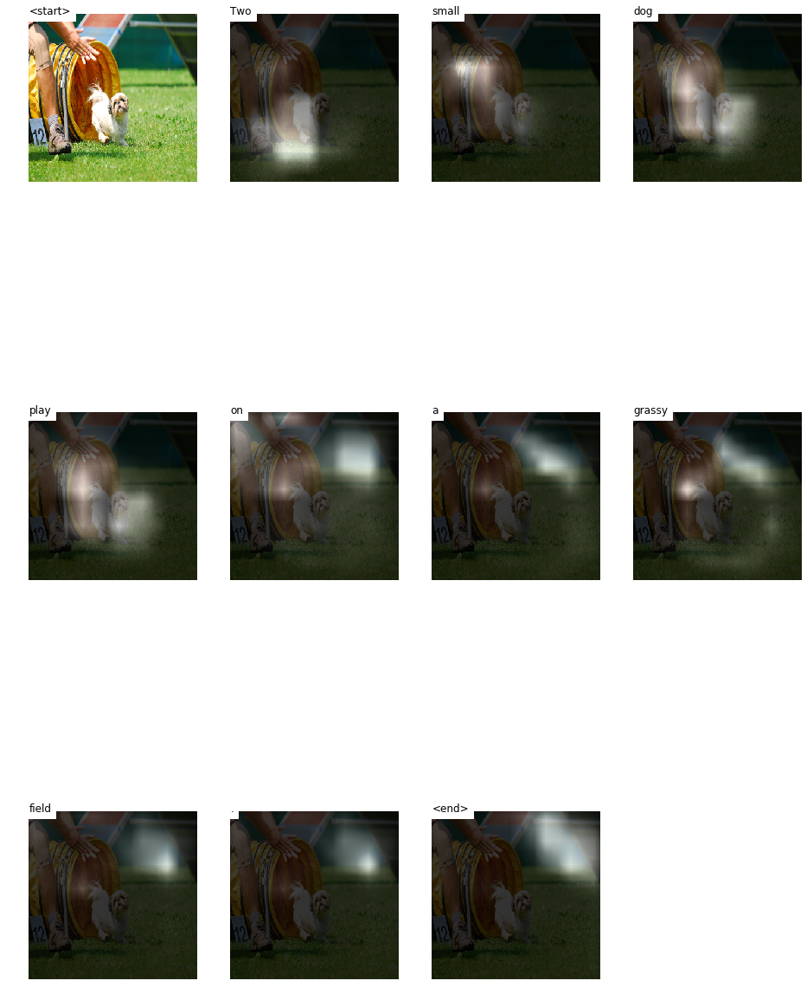




IMAGE PATH: /content/drive/My Drive/hw2/test20/1269470943_ba7fc49b4d.jpg 




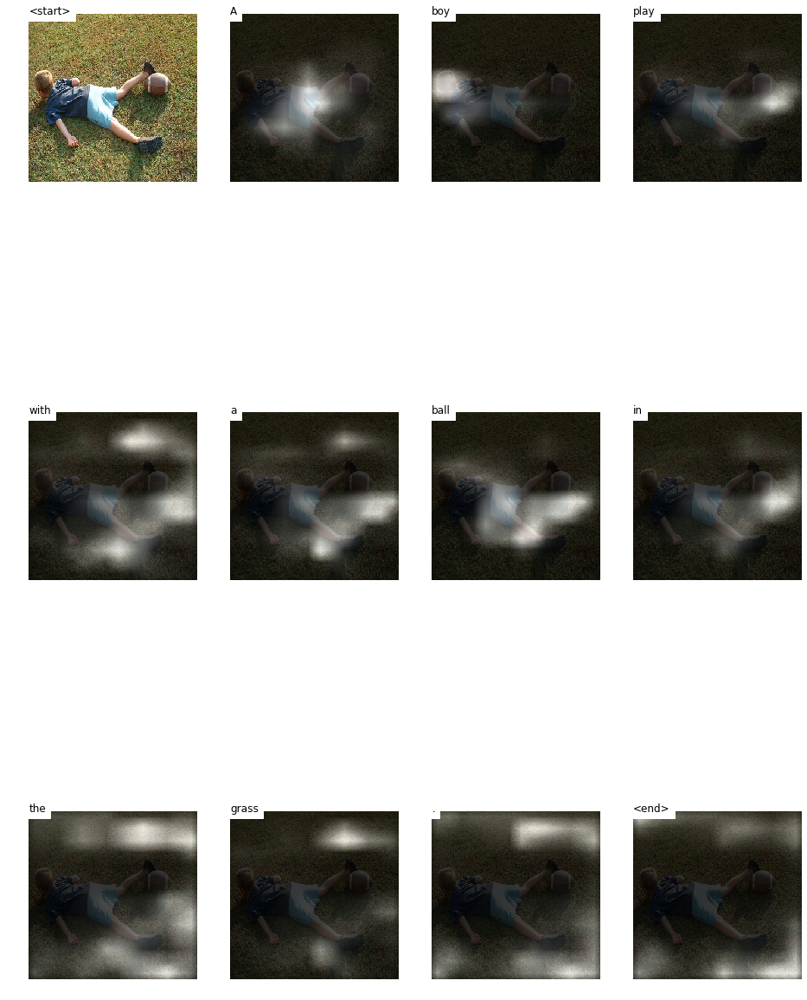




IMAGE PATH: /content/drive/My Drive/hw2/test20/3609999845_faf5d2fe74.jpg 




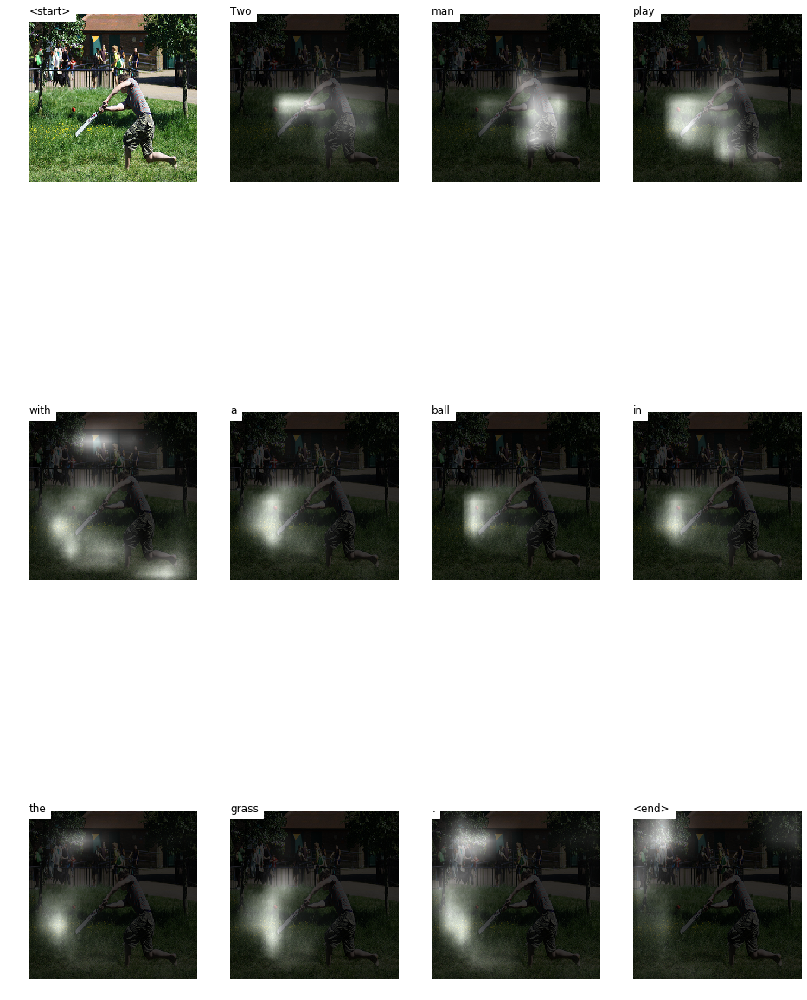




IMAGE PATH: /content/drive/My Drive/hw2/test20/1547883892_e29b3db42e.jpg 




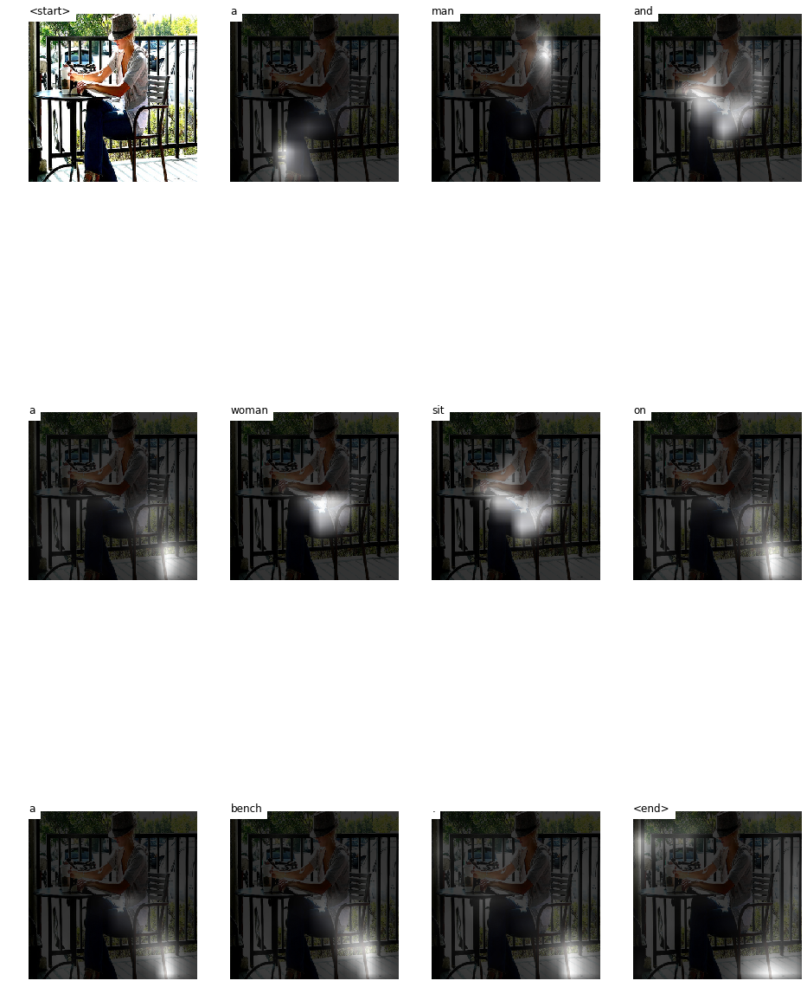




IMAGE PATH: /content/drive/My Drive/hw2/test20/1138784872_69ade3f2ab.jpg 




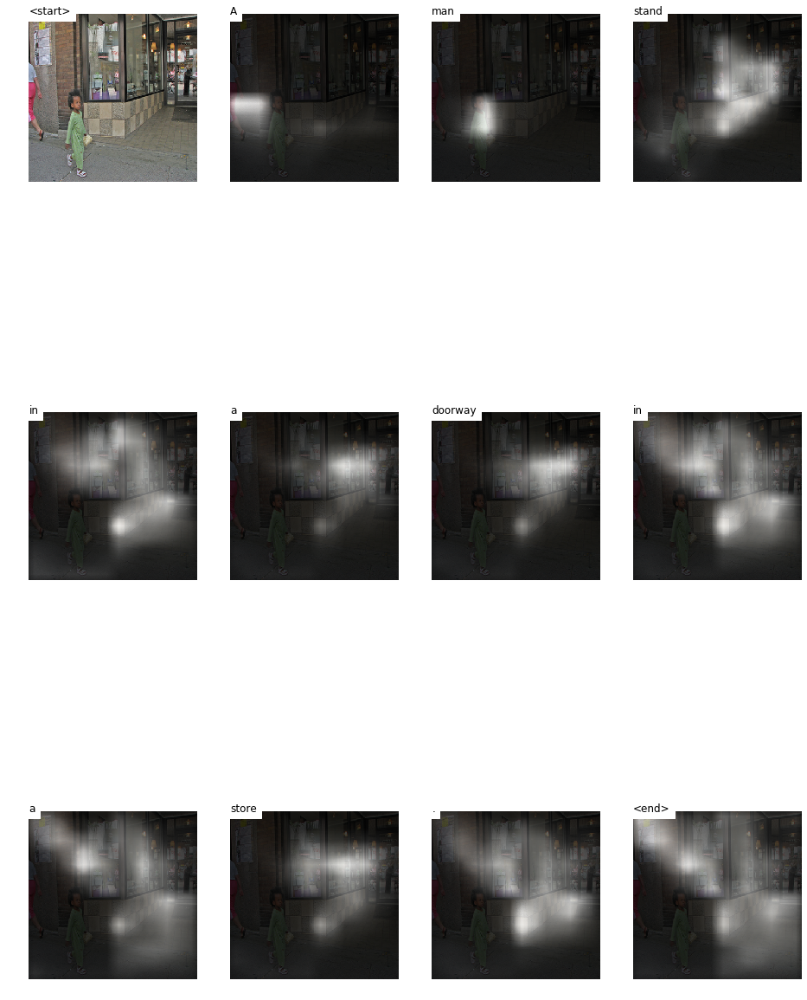




IMAGE PATH: /content/drive/My Drive/hw2/test20/3394654132_9a8659605c.jpg 




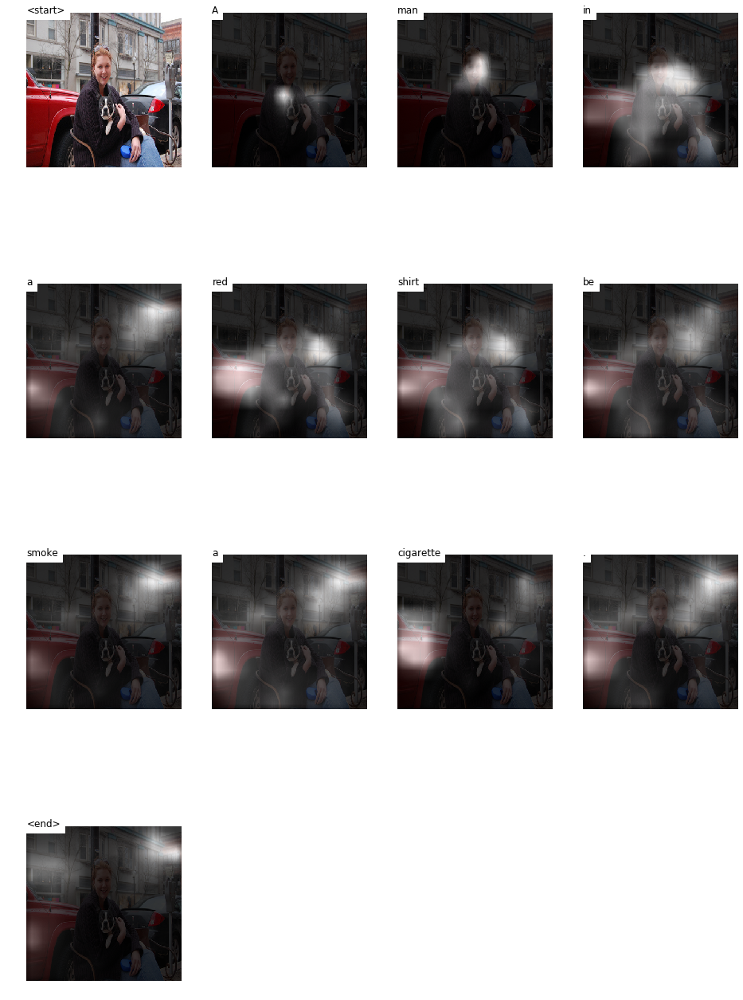




IMAGE PATH: /content/drive/My Drive/hw2/test20/2169951750_495820a215.jpg 




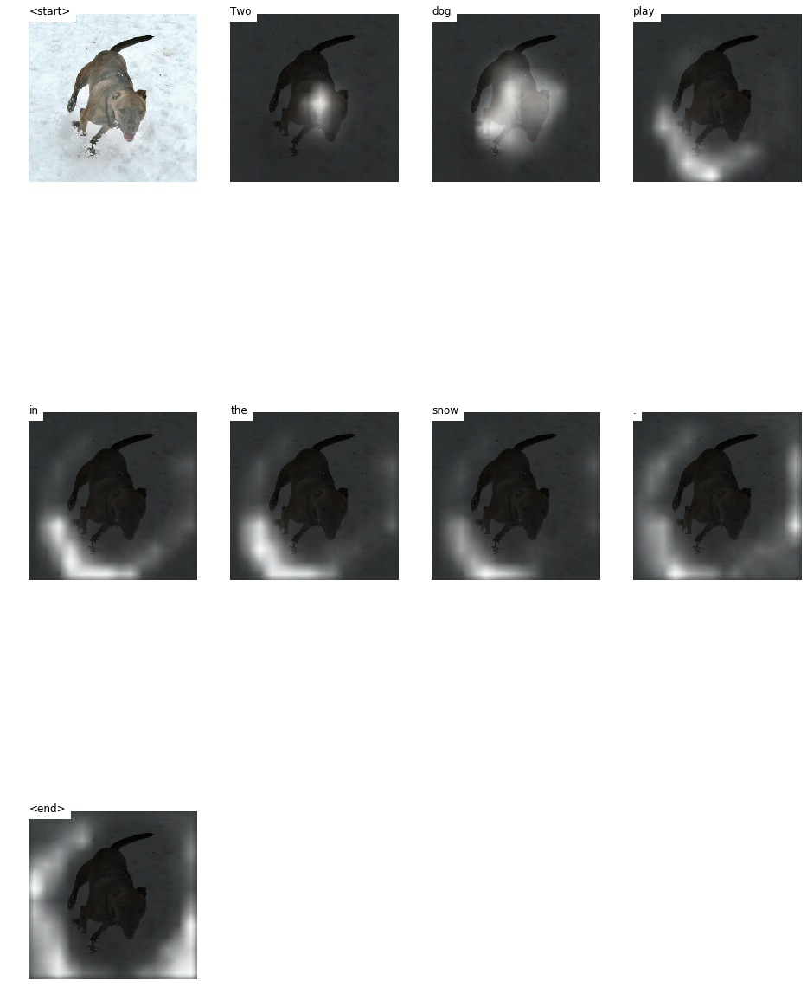




IMAGE PATH: /content/drive/My Drive/hw2/test20/3109704348_c6416244ce.jpg 




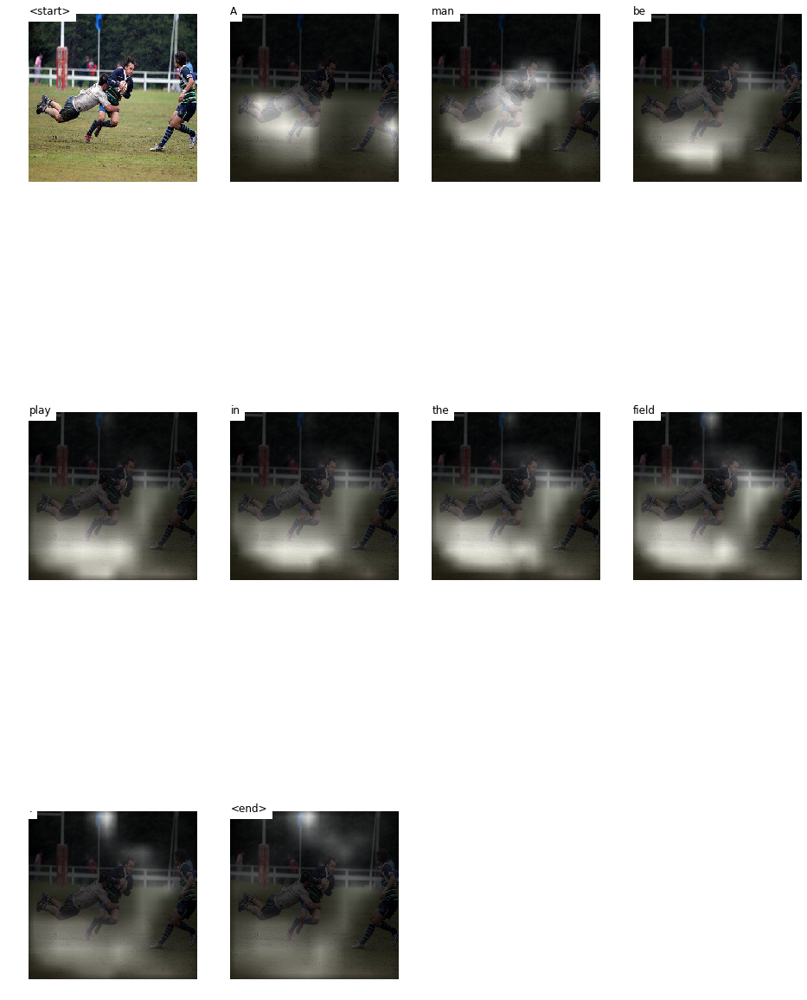




IMAGE PATH: /content/drive/My Drive/hw2/test20/2572101672_4d699c8713.jpg 




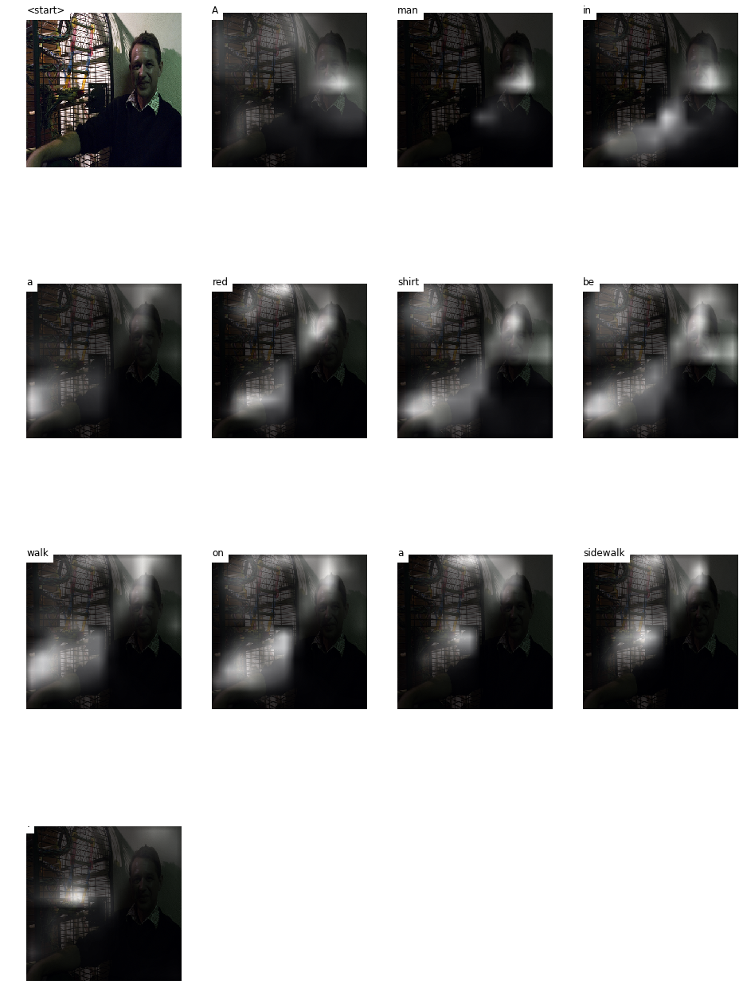




IMAGE PATH: /content/drive/My Drive/hw2/test20/3702038926_966fdaa311.jpg 




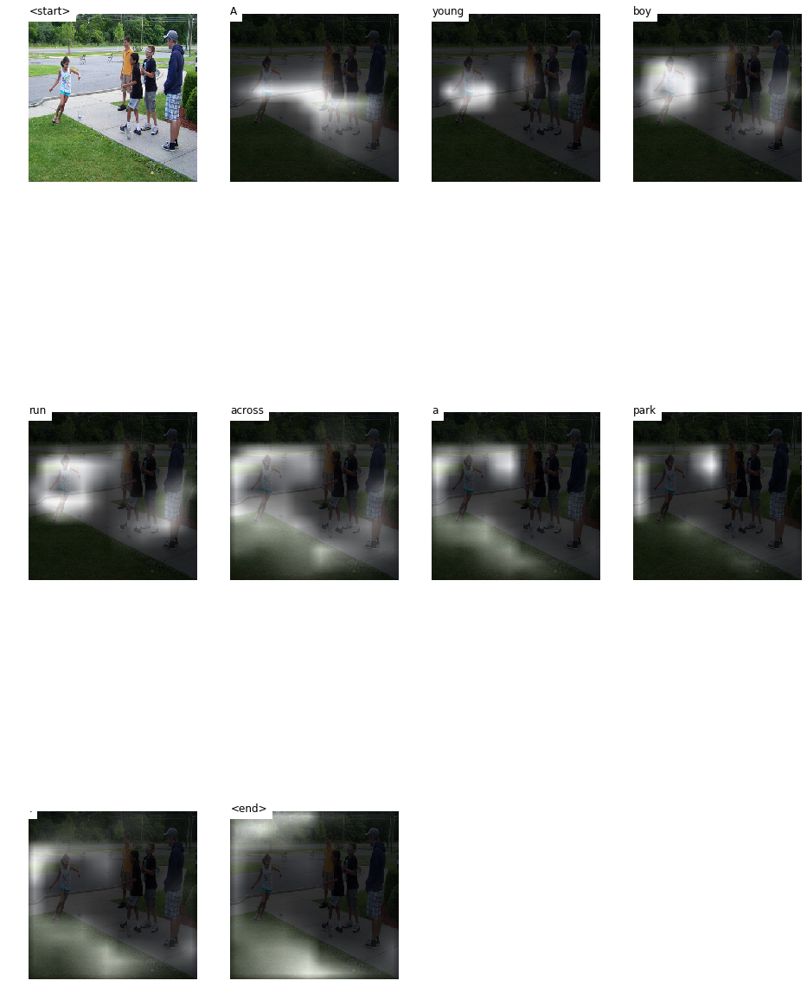




IMAGE PATH: /content/drive/My Drive/hw2/test20/3514019869_7de4ece2a5.jpg 




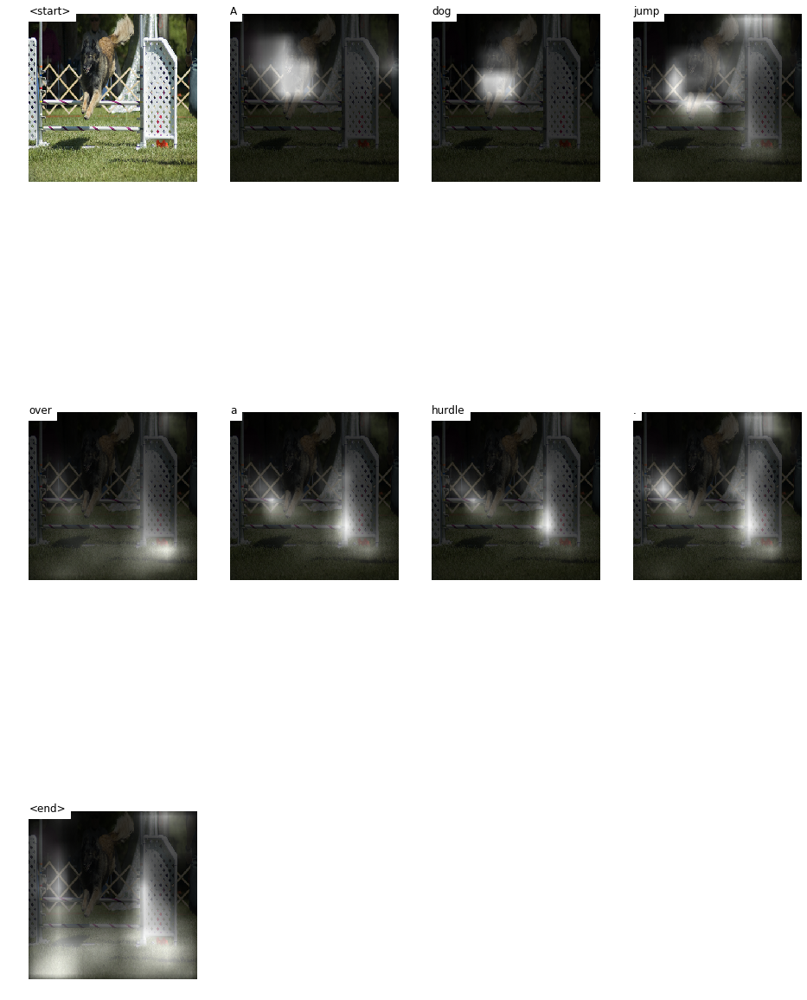




IMAGE PATH: /content/drive/My Drive/hw2/test20/3225226381_9fe306fb9e.jpg 




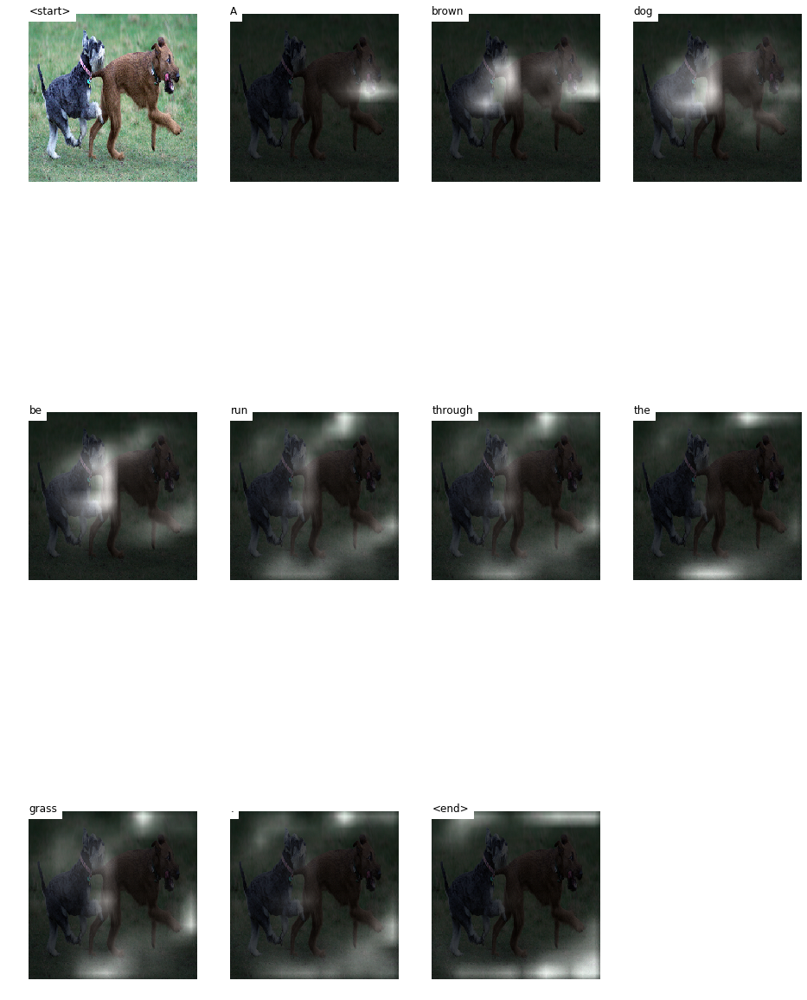




IMAGE PATH: /content/drive/My Drive/hw2/test20/2381583688_a6dd0a7279.jpg 




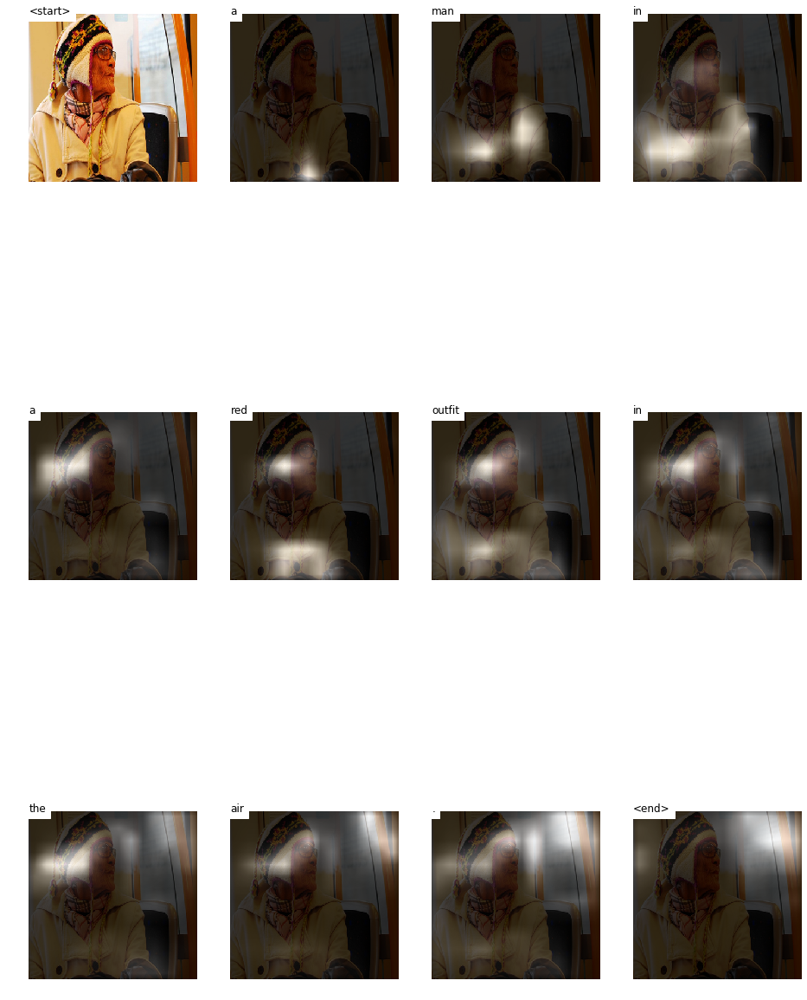




IMAGE PATH: /content/drive/My Drive/hw2/test20/3183060123_ea3af6278b.jpg 




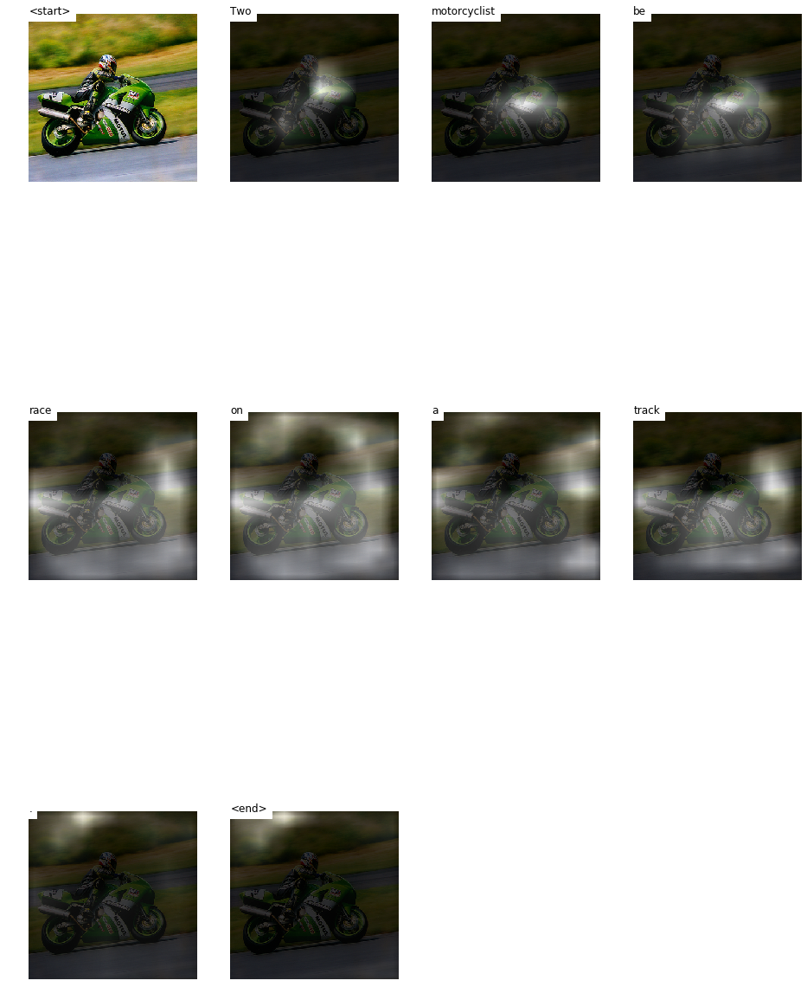




IMAGE PATH: /content/drive/My Drive/hw2/test20/1311132744_5ffd03f831.jpg 




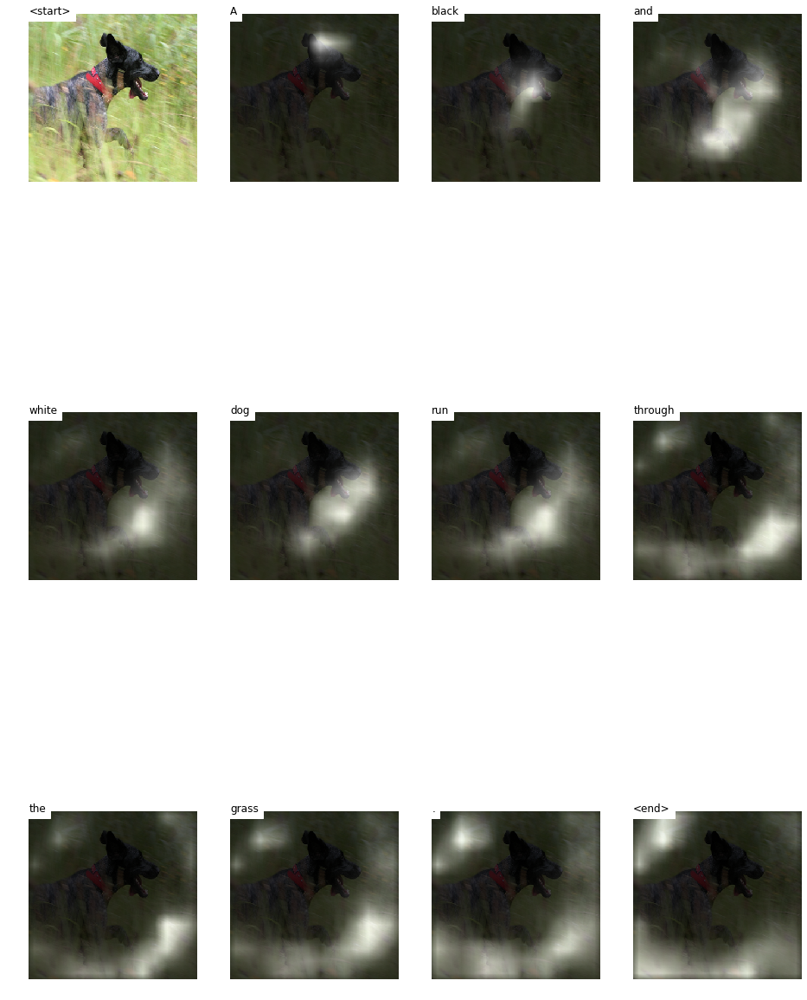




IMAGE PATH: /content/drive/My Drive/hw2/test20/575636303_b0b8fd4eee.jpg 




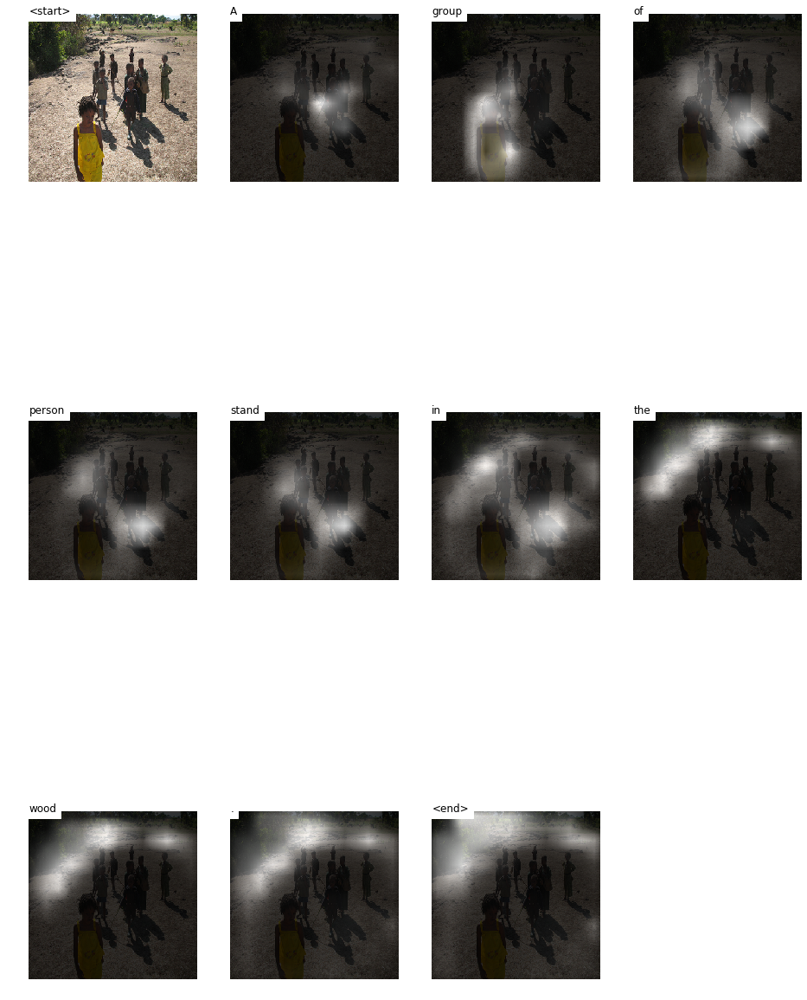




IMAGE PATH: /content/drive/My Drive/hw2/test20/2066271441_1f1f056c01.jpg 




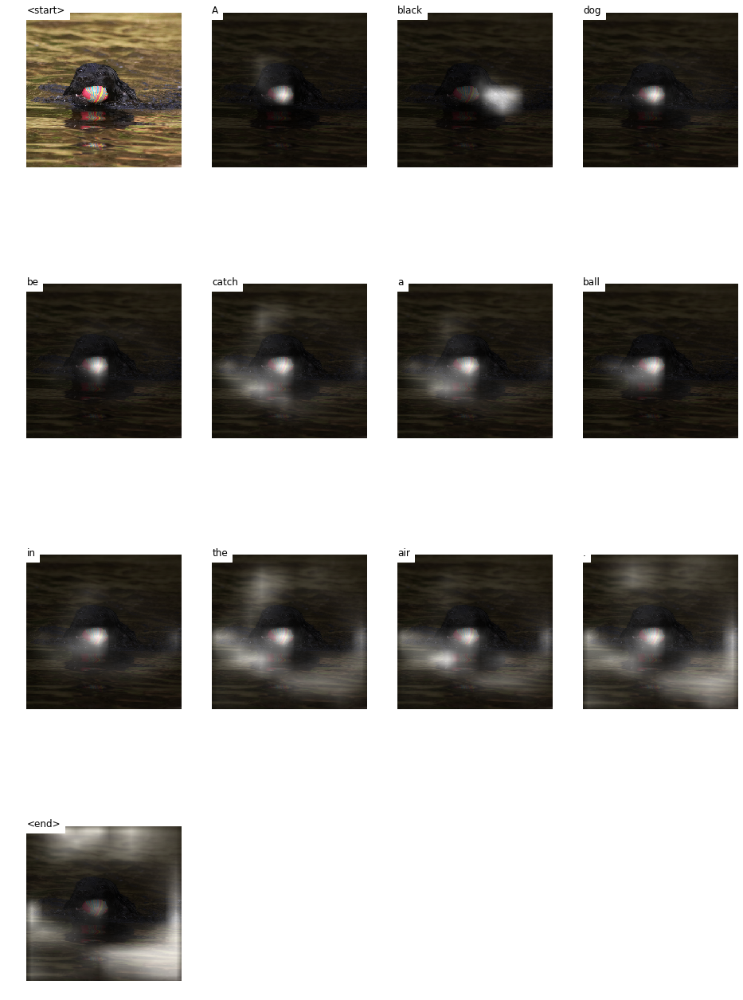




IMAGE PATH: /content/drive/My Drive/hw2/test20/2298283771_fb21a4217e.jpg 




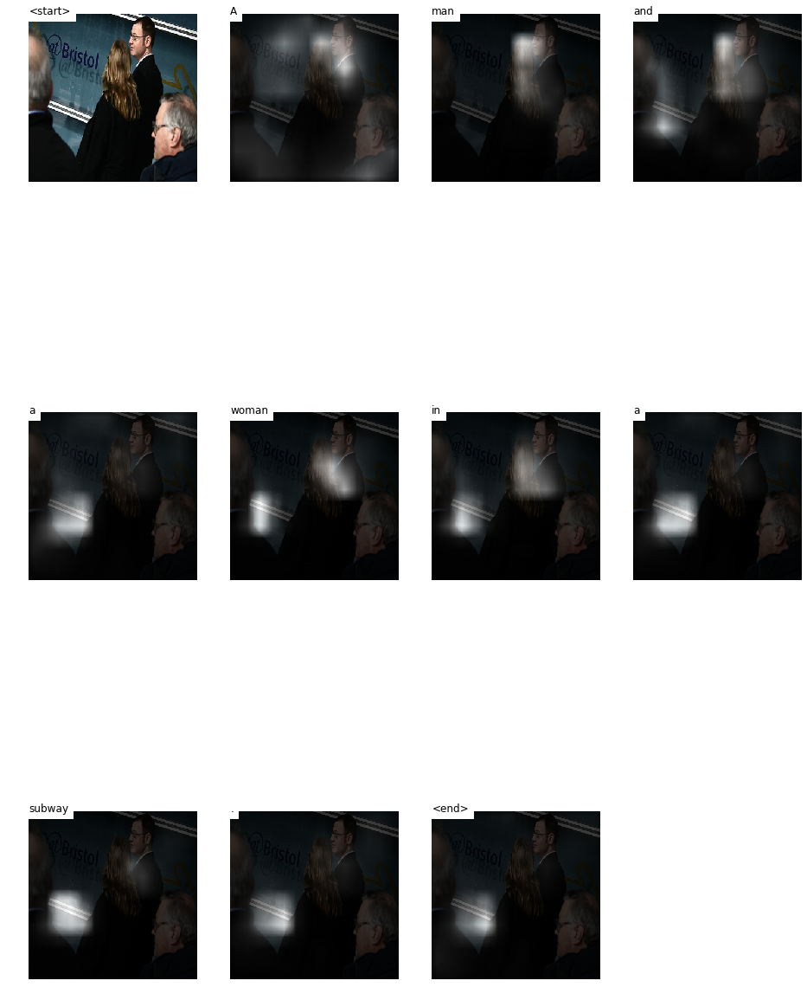




IMAGE PATH: /content/drive/My Drive/hw2/test20/1489286545_8df476fa26.jpg 




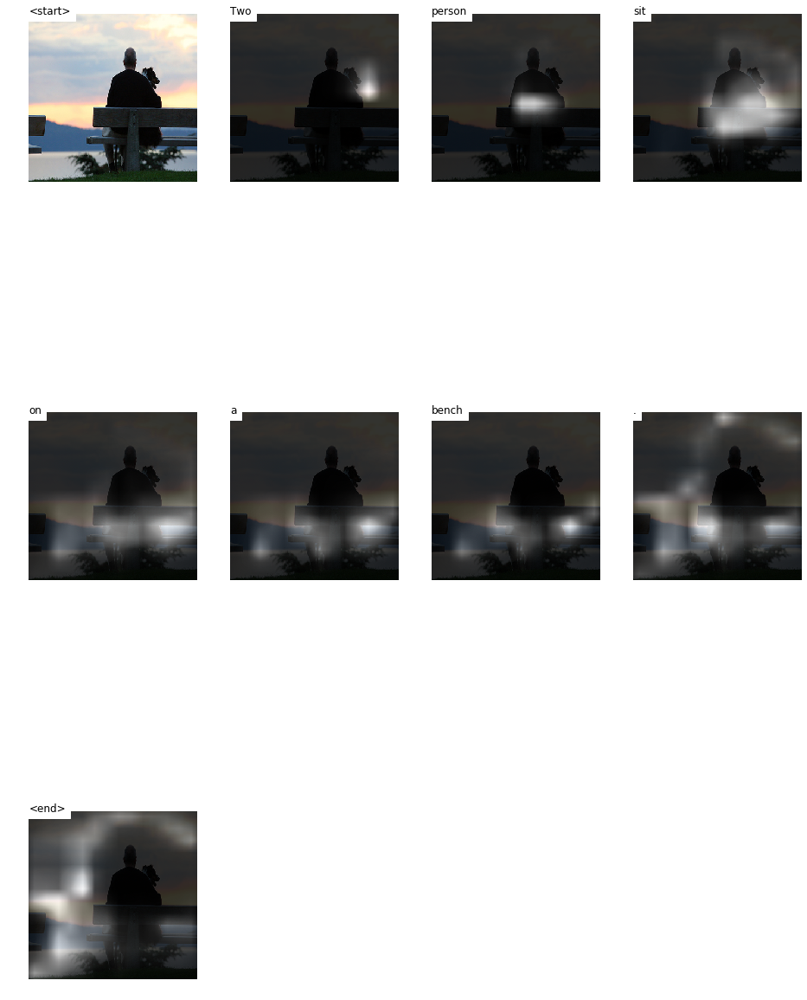




IMAGE PATH: /content/drive/My Drive/hw2/test20/2695085862_2ed62df354.jpg 




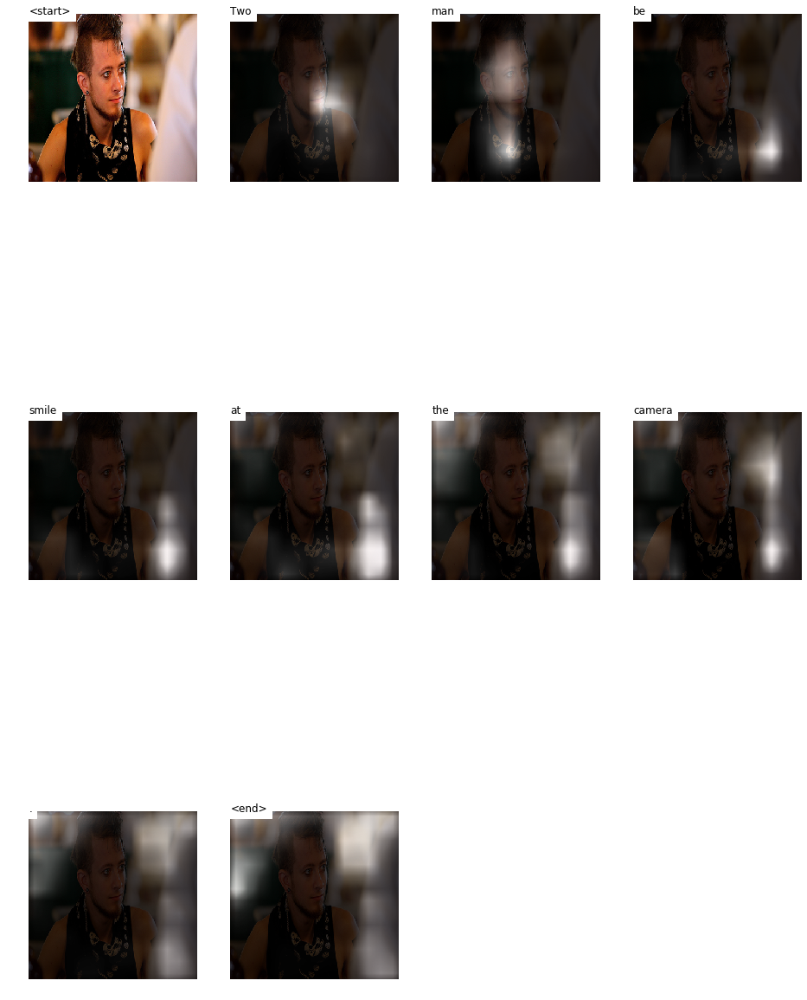

In [0]:
import warnings
warnings.filterwarnings('ignore')

for im_p in os.listdir('/content/drive/My Drive/hw2/test20/'):
  image_path = '/content/drive/My Drive/hw2/test20/' + im_p
  print("IMAGE PATH: {} \n\n".format(image_path))
  encoder.eval()
  decoder.eval()
  final_caption, final_weight = caption_image_beam_search(encoder, decoder, image_path, word_map, k=3)
  final_weight = torch.FloatTensor(final_weight)
  visualize_att(image_path, final_caption, final_weight, ix2word)
  print("\n\n")
  

### 5 test images

IMAGE PATH: /content/drive/My Drive/hw2/test5/6.jpg 




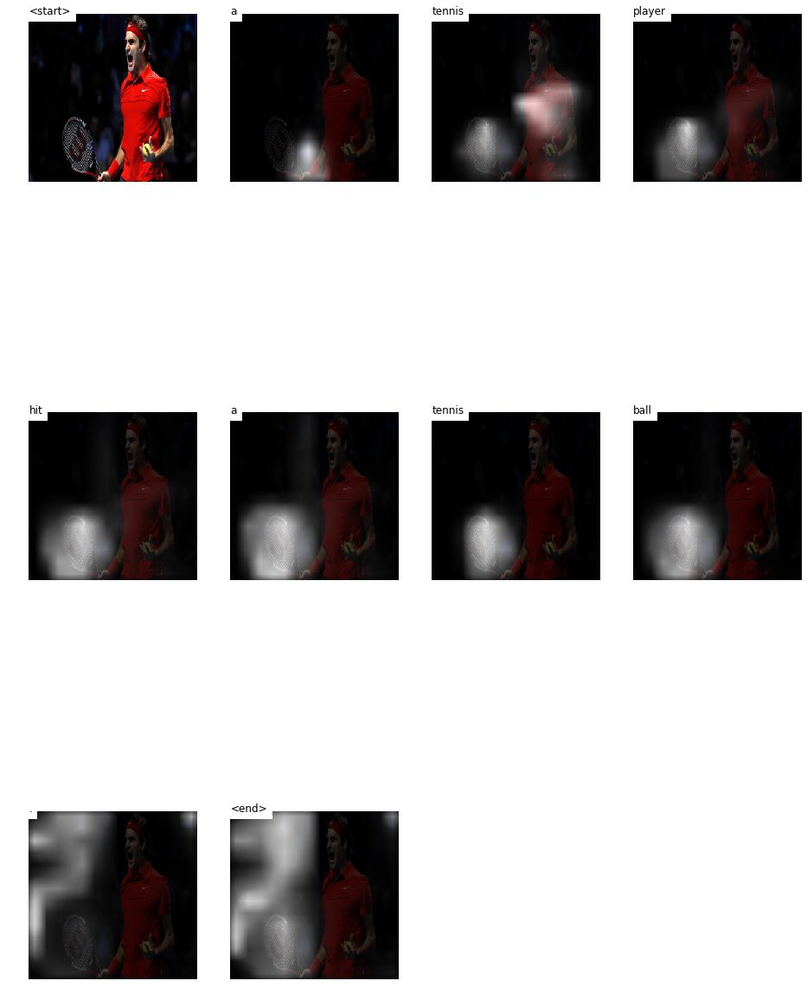

IMAGE PATH: /content/drive/My Drive/hw2/test5/2.jpg 




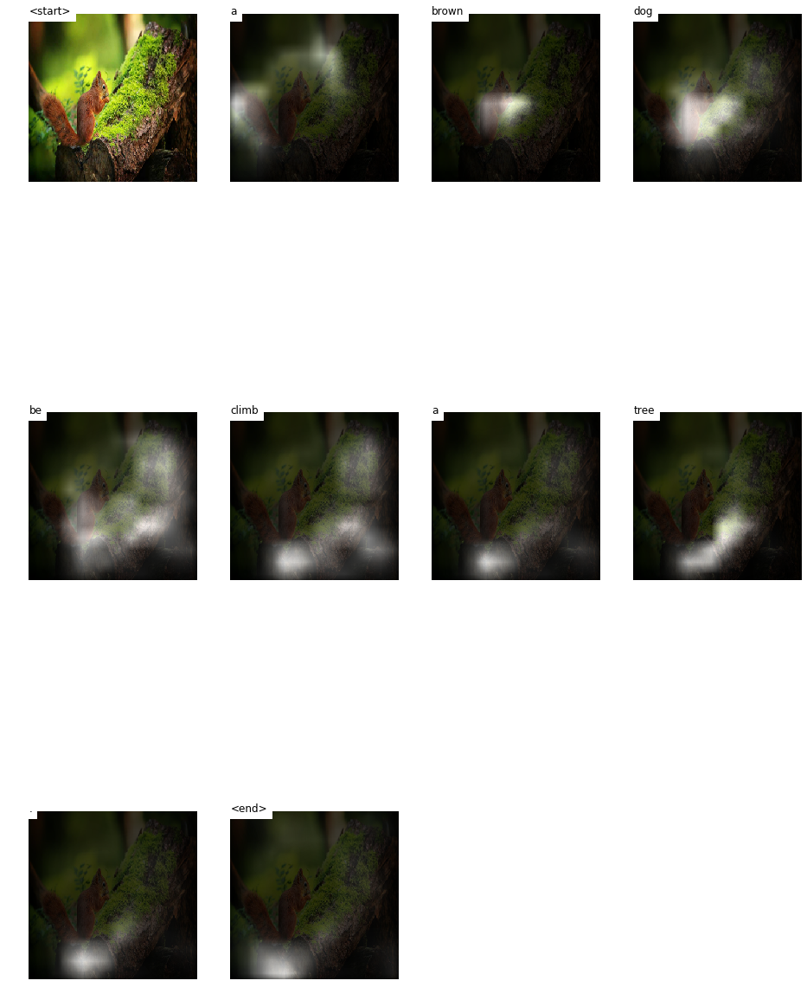

IMAGE PATH: /content/drive/My Drive/hw2/test5/1.jpg 




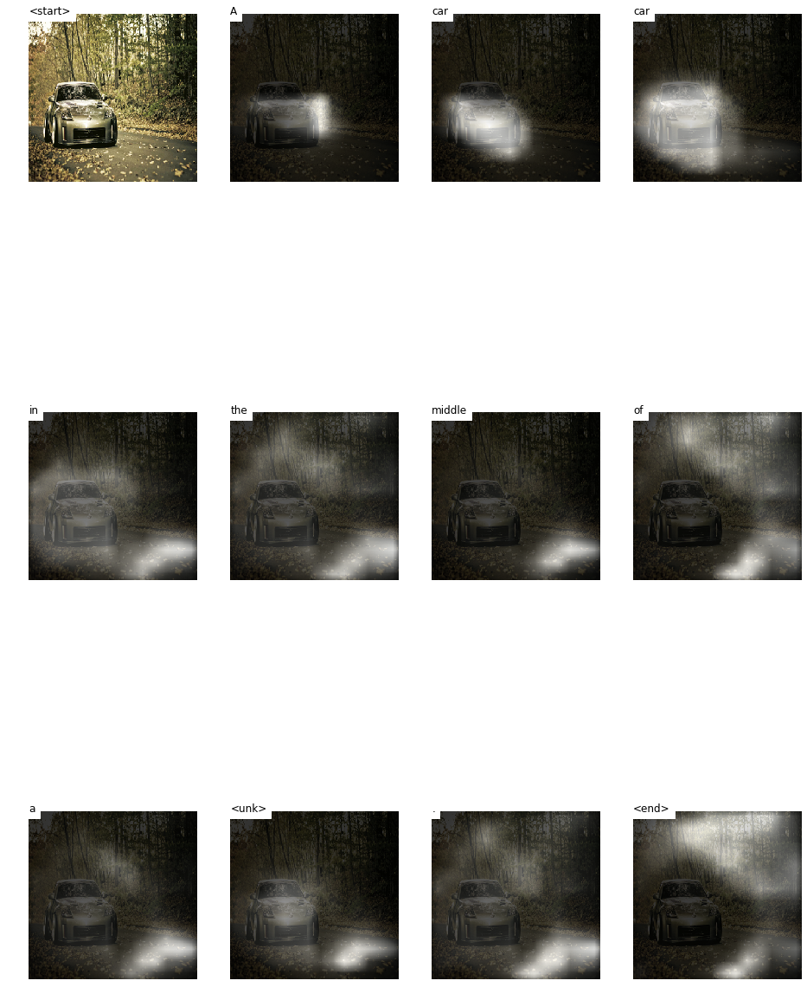

IMAGE PATH: /content/drive/My Drive/hw2/test5/3.jpg 




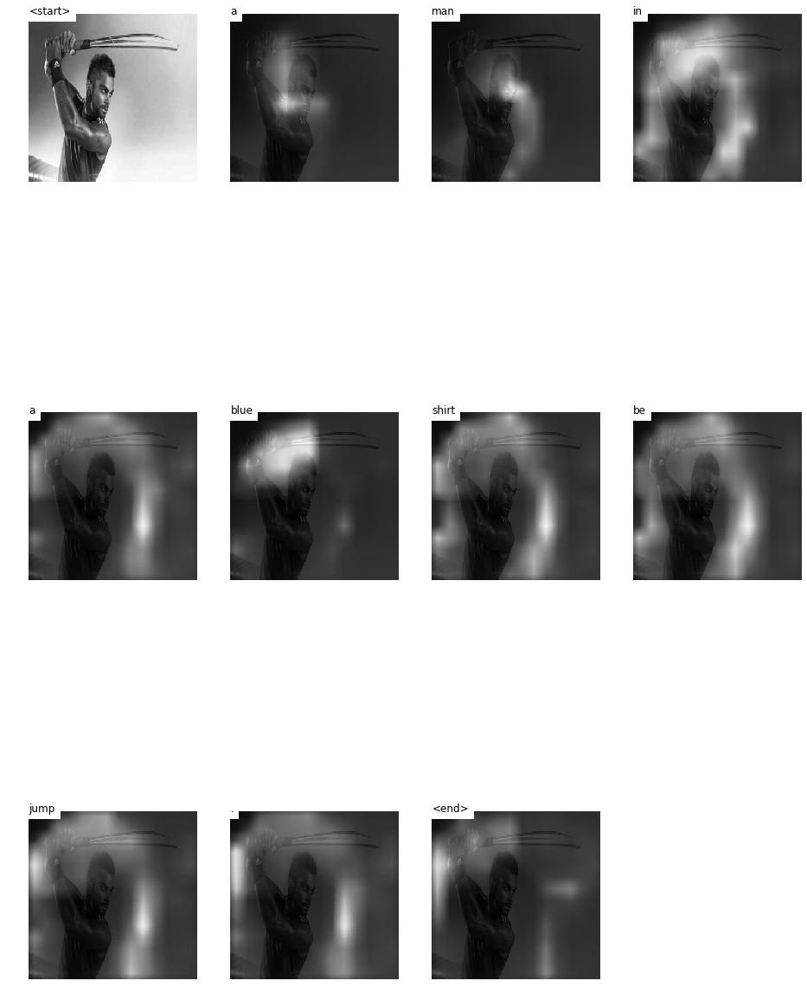

IMAGE PATH: /content/drive/My Drive/hw2/test5/4.jpg 




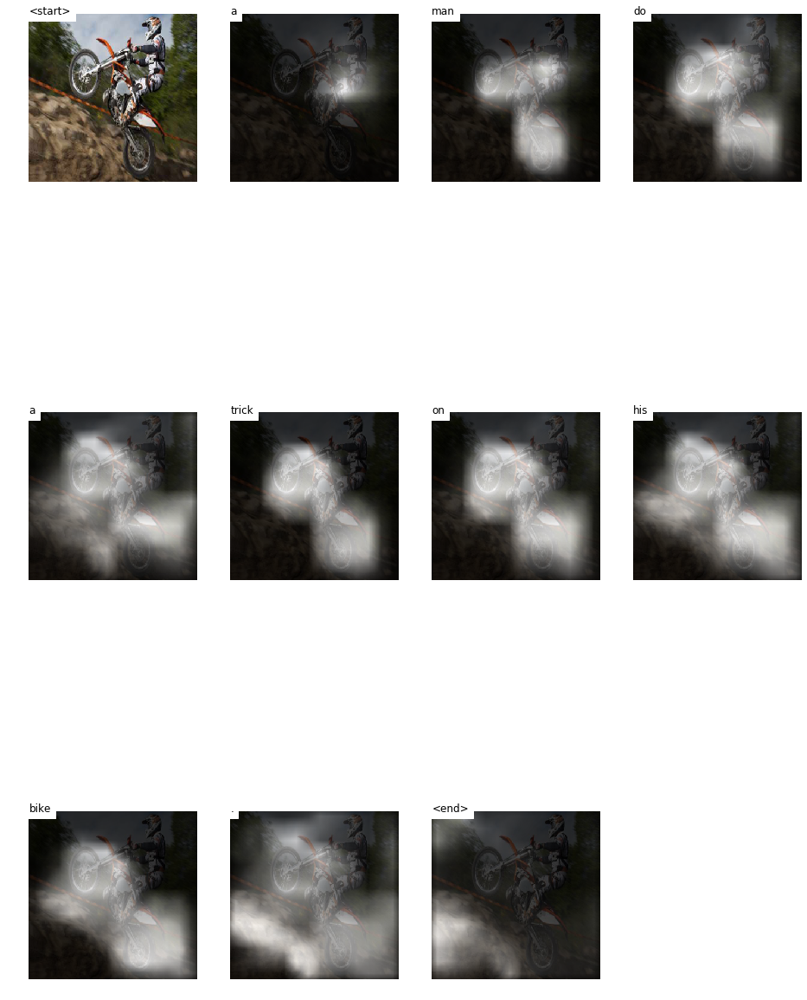

IMAGE PATH: /content/drive/My Drive/hw2/test5/5.jpg 




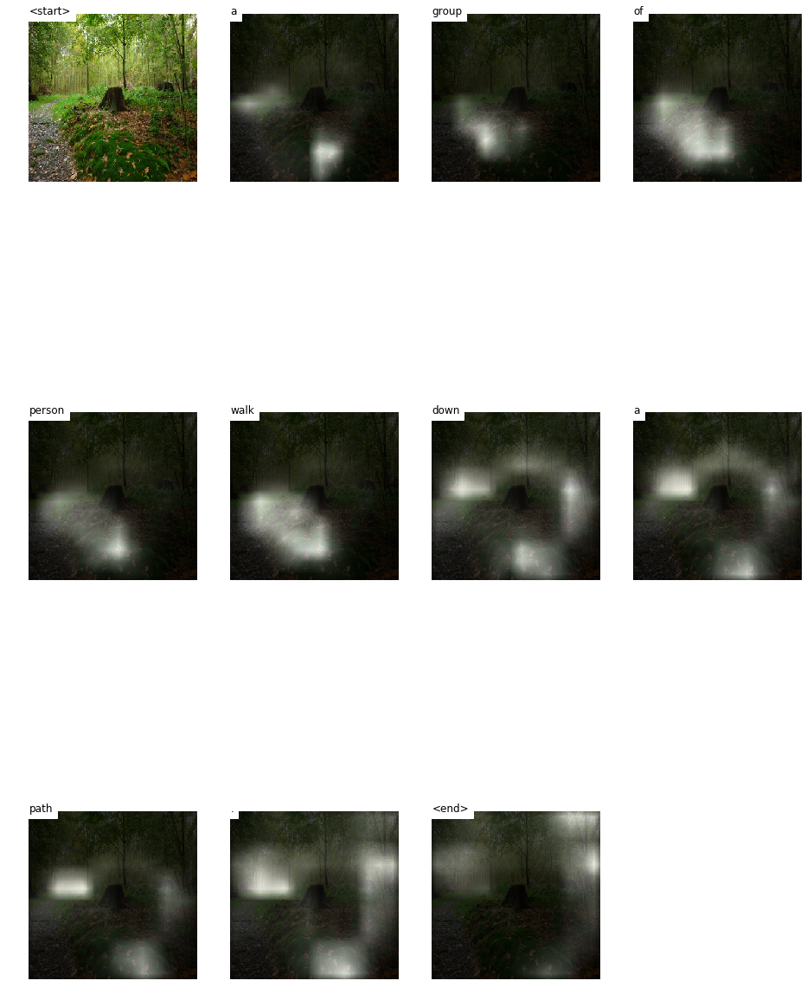

In [0]:
import warnings
warnings.filterwarnings('ignore')

for im_p in os.listdir('/content/drive/My Drive/hw2/test5/'):
  image_path = '/content/drive/My Drive/hw2/test5/' + im_p
  print("IMAGE PATH: {} \n\n".format(image_path))
  encoder.eval()
  decoder.eval()
  final_caption, final_weight = caption_image_beam_search(encoder, decoder, image_path, word_map, k=3)
  final_weight = torch.FloatTensor(final_weight)
  visualize_att(image_path, final_caption, final_weight, ix2word)
  